
# Vehicle detection and tracking

Using techniques of computer vision and machine learning we build a vehicle detector that tracks cars in a video.

Performing Histogram of Oriented Gradients (HOG) and color histograms we extract features from images. 
This features are used to predict with a linear SVM the presence or not of vehicles.

The linear svm classifier is trained with a set of 64x64x3 labeled images.

To detect the vehicles in a larger image we use the sliding windows technique to estimate a bounding box for vehicles detected.

Finally the clasifier is run in the video pipeline. Previous frames are used to eliminate false positives from the tracking.


In [80]:
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import matplotlib.image as mpimage
import tensorflow as tf
import numpy as np
from sklearn.metrics import confusion_matrix
from sklearn.utils import shuffle
import time
from datetime import timedelta
import math
import pickle
import PIL.Image
import IPython.display
import matplotlib.gridspec as gridspec
import os
import cv2
import glob
from skimage.feature import hog
from skimage import data, color, exposure
from IPython.display import display
from ipywidgets import interact, interactive, fixed, interact_manual, FloatSlider, IntSlider
from sklearn.model_selection import GridSearchCV
import ipywidgets as widgets
from sklearn.cross_validation import train_test_split
from sklearn.preprocessing import StandardScaler


# Imports to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

## Inspect data

As a first step we inspect the images in the dataset. We have 2 folders, vehicles and non-vehicles, with a set of images that we use for training or classifier.

In [2]:
def load_images(pattern):
    '''
    load a set of images
    '''
    return [cv2.cvtColor(cv2.imread(file), cv2.COLOR_BGR2RGB) for file in glob.glob(pattern)]

In [3]:
def show_images(images, figsize=(20,10), nrows=5, ncols=5, cmap=None):
    '''
    show a set of images in a grid
    '''
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    for image, ax in zip(images,axes.flat):
        ax.imshow(image, cmap=cmap)


First we show a set of vehicle images.

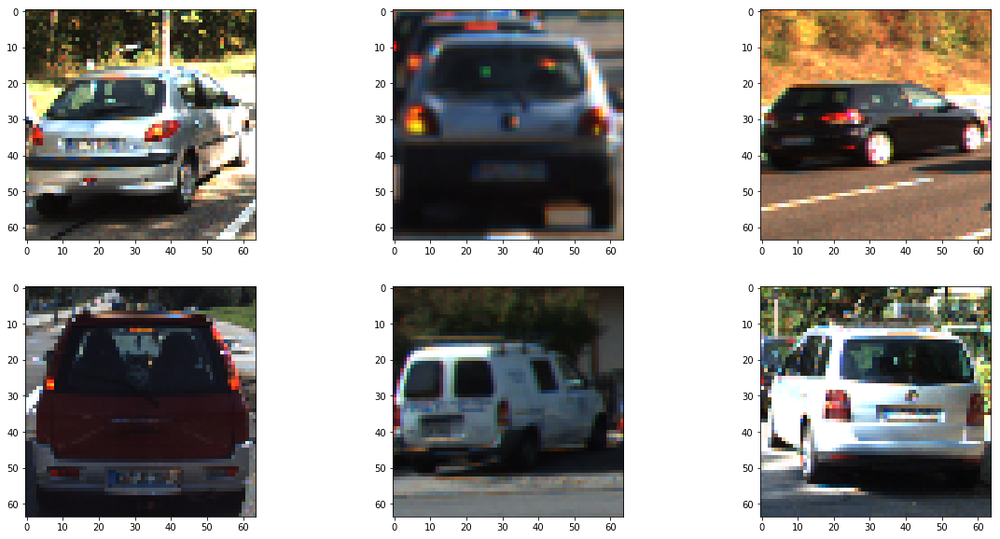

In [4]:
#set of vehicle images
vehicle_images = load_images('./vehicles/**/*.png')
show_images(vehicle_images, ncols=3, nrows=2)

Now we show the non-vehicles set.

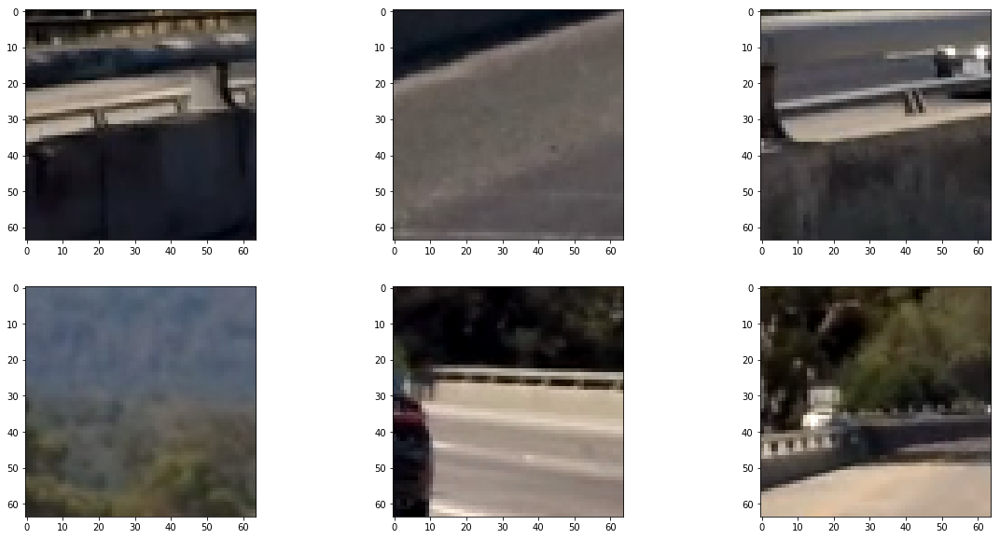

In [5]:
#non vehicle images
non_vehicle_images = load_images('./non-vehicles/**/*.png')
show_images(non_vehicle_images, ncols=3, nrows=2)

## Feature extraction

To work with a classifier we are going to transform the images to vectors. We use feature extraction to build those vectors. Feature extraction allow us to use informative and not redundant values.


### Extract HOG features

The histogram of oriented gradients (HOG) is a feature descriptor used in computer vision and image processing for the purpose of object detection. The technique counts occurrences of gradient orientation in localized portions of an image. This method is similar to that of edge orientation histograms, scale-invariant feature transform descriptors, and shape contexts, but differs in that it is computed on a dense grid of uniformly spaced cells and uses overlapping local contrast normalization for improved accuracy.

Using only HOG features the classifier has a precission of 0.96. We  will use other features to improve this value.

In [6]:
# Define a function to return HOG features and visualization
def feature_extraction(img, img_transformation = color.rgb2gray, orient=9, pix_per_cell=8, cell_per_block=2, vis=False, feature_vec=True):
    img = img_transformation(img)
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                                  visualise=True, feature_vector=False)
        return features, hog_image
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                       visualise=False, feature_vector=feature_vec)
        return features

In [7]:
def show_features(images):
    fig, axes = plt.subplots(nrows=len(images), ncols=2, figsize=(40, 20), sharex=True, sharey=True)
    for i,image in enumerate(images):
        hog_image = feature_extraction(image, vis=True)[1]
        ax1 = axes.flat[2*i]
        ax2 = axes.flat[2*i+1]
        ax1.axis('off')
        ax1.imshow(image)
        ax1.set_title('Input image')
        ax1.set_adjustable('box-forced')

        ax2.axis('off')
        ax2.imshow(hog_image, cmap=plt.cm.gray)
        ax2.set_title('Histogram of Oriented Gradients')
        ax1.set_adjustable('box-forced')
    plt.show()
    
        

We show many examples of images to see the HOG result.

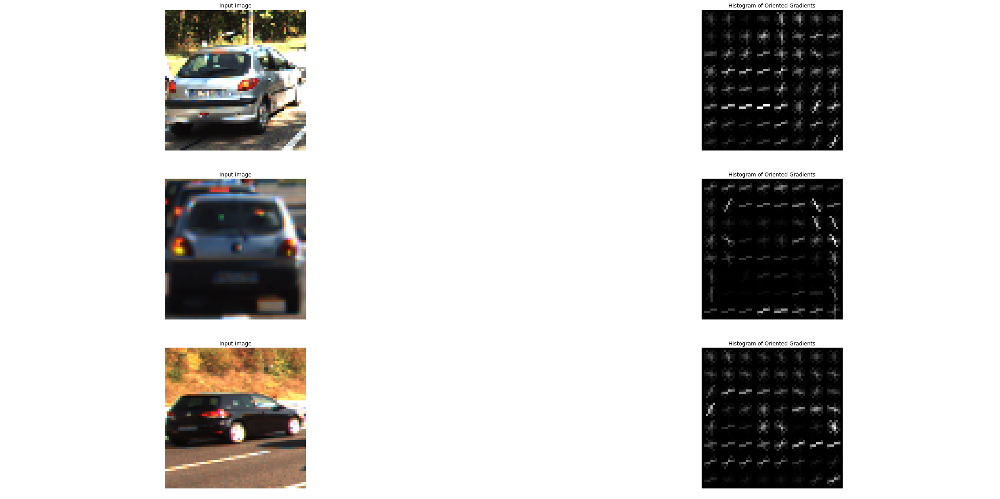

In [8]:
show_features(vehicle_images[:3])

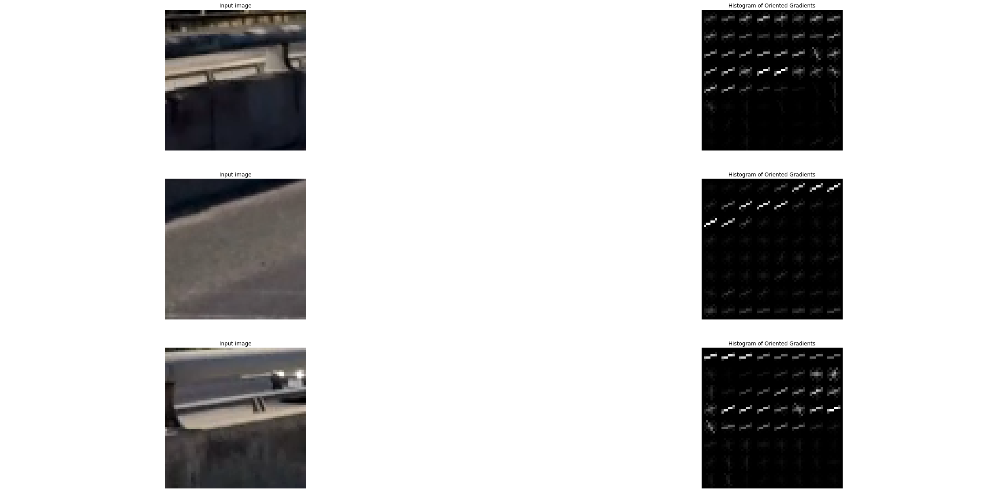

In [9]:
show_features(non_vehicle_images[:3])

## Build dataset

We use the images in the folders vehicles and non-vehicles to build a labeled images dataset. We fix the random_state in shuffling and train/test split for having consistent results during our exploration.
We don't use a validation set. We work with GridSearchCV. GridSearchCV uses cross validation.

In [10]:
def build_dataset(
        vehicles=vehicle_images,
        non_vehicles=non_vehicle_images,
        test_size=0.2):
    X = []
    X.extend(vehicles)
    X.extend(non_vehicles)
    X = np.array(X)
    Y = np.hstack((np.ones(len(vehicles)), 
              np.zeros(len(non_vehicles))))
    X,Y = shuffle(X,Y, random_state=42)
    return train_test_split(X, Y, test_size=test_size, random_state=42)

X_train, X_test, Y_train, Y_test = build_dataset()
print("X train shape", X_train.shape)
print("X test shape" , X_test.shape)
print("Y train shape", Y_train.shape)
print("Y test shape" , Y_test.shape)

X train shape (14208, 64, 64, 3)
X test shape (3552, 64, 64, 3)
Y train shape (14208,)
Y test shape (3552,)


We have 14208 images for training and 3552 for testing. The images are 64x64x3.

## Build the classifier pipeline

For building the pipeline we use different components.
- The transformers take and image and changes the format. We use only a color space transformer.
- The featurizers extracts features from an image. We consider the hog, bin space and color histogram featurizers.


### Color space transformer

Allow us to change the color space of the images in the dataset. 

In [11]:
from sklearn.base import TransformerMixin, BaseEstimator

class CSpaceTransformer(BaseEstimator, TransformerMixin):
    '''
    Transform images to new color space
    '''
    def __init__(self, cspace="rgb"):
        '''
        cspacecan be rgb, hsv, luv, hls, yuv, ycrcb
        '''
        self.cspace = cspace
        self.cspace_map = dict(
            hsv = cv2.COLOR_RGB2HSV, 
            luv=cv2.COLOR_RGB2LUV, 
            hls=cv2.COLOR_RGB2HLS,
            yuv=cv2.COLOR_RGB2YUV,
            ycrcb=cv2.COLOR_RGB2YCrCb
        )

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        if self.cspace=="rgb":
            return X
        return np.array([cv2.cvtColor(x, self.cspace_map[self.cspace]) for x in X])


X_transformed = CSpaceTransformer(cspace='luv').transform(X_train)
print("Color space shape", X_transformed.shape)

Color space shape (14208, 64, 64, 3)


### HOG featurizer

This featurizer calculates the hog features of an image.

In [12]:
class HOGFeaturizer(BaseEstimator, TransformerMixin):
    def __init__(self, hog_channel=0, orientations = 9, pix_per_cell=8, cell_per_block=2, transform_sqrt=True):
        self.hog_channel = 0
        self.orientations = orientations
        self.pix_per_cell= pix_per_cell
        self.cell_per_block = cell_per_block
        self.transform_sqrt = transform_sqrt

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        def get_hog_features(img):
            if self.hog_channel == 'ALL':
                hog_features = []
                for channel in range(img.shape[2]):
                    hog_features.append(hog(img[:,:,channel], 
                         orientations = self.orientations,
                         pixels_per_cell = (self.pix_per_cell, self.pix_per_cell),
                         cells_per_block = (self.cell_per_block, self.cell_per_block),
                         transform_sqrt = self.transform_sqrt,
                         visualise = False,
                         feature_vector = True))
                return np.ravel(hog_features)        
            else:
                return hog(img[:,:,self.hog_channel], 
                     orientations = self.orientations,
                     pixels_per_cell = (self.pix_per_cell, self.pix_per_cell),
                     cells_per_block = (self.cell_per_block, self.cell_per_block),
                     transform_sqrt = self.transform_sqrt,
                     visualise = False,
                     feature_vector = True)
        return np.array([get_hog_features(x) for x in X])
        

hog_features = HOGFeaturizer().transform(X_train)
print("HOG features shape", hog_features.shape)

HOG features shape (14208, 1764)


### Bin spatial featurizer

This featurizer resizes the image and takes the resulting pixels as a vector.

In [13]:
class BinSpatialFeaturizer(BaseEstimator, TransformerMixin):
    def __init__(self, size=(32, 32)):
        self.size = size

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return np.array([ cv2.resize(x,self.size).ravel() for x in X])

bin_spatial_features = BinSpatialFeaturizer().transform(X_train)
print("BinSpatial features shape", bin_spatial_features.shape)

BinSpatial features shape (14208, 3072)


### Color histogram featurizer

This featurizer concatenates the histograms for every channel of the image. The result is a vector.

In [14]:
class ColorHistFeaturizer(BaseEstimator, TransformerMixin):
    def __init__(self, nbins=32, bins_range=(0,256)):
        self.nbins = nbins
        self.bins_range = bins_range

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        def color_hist(img):
            channel1_hist = np.histogram(img[:,:,0], bins=self.nbins, range=self.bins_range)
            channel2_hist = np.histogram(img[:,:,1], bins=self.nbins, range=self.bins_range)
            channel3_hist = np.histogram(img[:,:,2], bins=self.nbins, range=self.bins_range)
            return np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
        return np.array([ color_hist(x) for x in X])
    
color_hist_features = ColorHistFeaturizer().transform(X_train)
print("ColorHist features shape", color_hist_features.shape)


ColorHist features shape (14208, 96)


### The classifier pipeline

We build a classifier pipeline with the transformers and featurizers presented above. We include a scaler to normalize between different features and a linear svm as classifier.
I use class Pipeline because it's more easy to explore different parameters with GridSearchCV later and it integrates well the training and the predicting phases. A problem that it has is that is more difficult to make some optimizations (like computing hog features for all the image and then split). So this arquitecture is not the fastest.

In [15]:
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.pipeline import FeatureUnion

pipeline = Pipeline([
    ('cspace', CSpaceTransformer()),
    ('features', FeatureUnion([
            ('hog',HOGFeaturizer()),
            ('bin_space', BinSpatialFeaturizer()),
            ('color_hist', ColorHistFeaturizer())
        ])
    ),
    ('scaler', StandardScaler()),
    ('clf', LinearSVC()),
])

pipeline.fit(X_train, Y_train)

clf = pipeline

score = pipeline.score(X_train, Y_train)
print("train score", score)

train score 1.0


We use a linear svm as the classifier. It's a good candidate for precission and speed.

In [16]:
class Config(dict):
    def __init__(self, *args, **kwargs):
        super(Config, self).__init__(*args, **kwargs)
        self.__dict__ = self

#we use the config object to store the best configuration for our classifier pipeline.
config = Config(clf__C=0.1,
               features__hog__hog_channel='ALL',
               cspace__cspace='ycrcb',
               features__transformer_weights = dict(hog=1,bin_space=1,color_hist=1),
               features__hog__pix_per_cell=12,
               features__hog__orientations=10,
               features__hog__cell_per_block=2,
               features__hog__transform_sqrt=False
)

In [17]:
def button(text):
    '''
    decorator for building a button
    '''
    def _build_button(action):
        btn = widgets.Button(description=text)
        display(btn)
        btn.on_click(action)
        return action
    return _build_button

def optimize_pipeline(
    clf__C=None,
    cspace__cspace=None,
    features__hog__hog_channel=None,
    features__transformer_weights=None,
    features__hog__pix_per_cell=None,
    features__hog__orientations=None,
    features__hog__cell_per_block=None,
    features__hog__transform_sqrt=None
):
    '''
    function to help optimize the classifier pipeline
    '''
    global config
    print("Optimizing ...")
    params = dict(
        clf__C= clf__C or [config.clf__C],
        cspace__cspace = cspace__cspace or [config.cspace__cspace],
        features__hog__hog_channel = features__hog__hog_channel or [config.features__hog__hog_channel],
        features__transformer_weights= features__transformer_weights or [config.features__transformer_weights],
        features__hog__pix_per_cell = features__hog__pix_per_cell or [config.features__hog__pix_per_cell],
        features__hog__orientations = features__hog__orientations or [config.features__hog__orientations],
        features__hog__cell_per_block = features__hog__cell_per_block or [config.features__hog__cell_per_block],
        features__hog__transform_sqrt = features__hog__transform_sqrt or [config.features__hog__transform_sqrt],
    )
    grid = GridSearchCV(pipeline, param_grid=params)
    grid.fit(X_train, Y_train)
    print("score", grid.best_score_)
    print("best parameters", grid.best_params_)
    config.update(grid.best_params_)
    print("config",config)
    print("End of optimizing")
    return grid
    

I optimize every feature alone. That is because training the classifier is very time consuming and trying all the differents features at the same time it would be worse. 

In [18]:
@button("Optimize C")
def click_optimize_C(event):
    optimize_pipeline(clf__C=[.01,.1,1,10])

The best option is C=0.1

In [19]:
@button("Optimize CSpace")
def click_optimize_color(event):
    optimize_pipeline(
        cspace__cspace="rgb luv hsv hls yuv ycrcb".split()
    )


The best result optained was with the ycrcb color space.

In [20]:
@button("Optimize HOG")
def click_optimize_hog(event):
    optimize_pipeline(
        features__hog__hog_channel=[0,1,2,'ALL']
    )


The best option is to use all the channels for hog features


We check all the combinations of the union of the 3 features (hog, bin space and color histogram) to determine the best set of features.

In [21]:
@button("Optimize Features")
def click_optimize_features(event):
    optimize_pipeline(
        features__transformer_weights=[dict(hog=1,bin_space=1,color_hist=1),
                                      dict(hog=0,bin_space=1,color_hist=1),
                                      dict(hog=1,bin_space=0,color_hist=1),
                                      dict(hog=1,bin_space=1,color_hist=0),
                                      dict(hog=1,bin_space=0,color_hist=0),
                                      dict(hog=0,bin_space=1,color_hist=0),
                                      dict(hog=0,bin_space=0,color_hist=1)]
    )


The best combination of features is using all 3. HOG, bin space and color histogram. Is also the most computational expansive.

In [22]:
@button("Optimize HOG size")
def click_optimize_hog_size(event):
    optimize_pipeline(
        features__hog__pix_per_cell=[6,8,10,12]
    )


The best size found is 12.

In [23]:
@button("Optimize HOG orientations")
def click_optimize_hog_orientations(event):
    optimize_pipeline(
        features__hog__orientations=[7,8,9,10,11]
    )

The best orientation was 10.

In [24]:
@button("Optimize HOG block")
def click_optimize_hog_block(event):
    optimize_pipeline(
        features__hog__cell_per_block=[1,2,3,4]
    )

The best result is with hog block size of 2

In [25]:
@button("Optimize HOG transform")
def click_optimize_hog_transform(event):
    optimize_pipeline(
        features__hog__transform_sqrt=[True, False]
    )

Using transform sqrt = False works better.

This option trains the classifier with the options in config.

In [26]:

@button("Train classifier")
def click_run(event):
    global clf
    clf = optimize_pipeline()
    print("Test score", clf.score(X_test, Y_test))

Optimizing ...
score 0.993384009009
best parameters {'features__hog__orientations': 10, 'features__hog__cell_per_block': 2, 'features__hog__pix_per_cell': 12, 'features__hog__transform_sqrt': False, 'clf__C': 0.1, 'cspace__cspace': 'ycrcb', 'features__hog__hog_channel': 'ALL', 'features__transformer_weights': {'hog': 1, 'color_hist': 1, 'bin_space': 1}}
config {'features__hog__orientations': 10, 'features__hog__cell_per_block': 2, 'features__hog__pix_per_cell': 12, 'clf__C': 0.1, 'cspace__cspace': 'ycrcb', 'features__hog__hog_channel': 'ALL', 'features__transformer_weights': {'hog': 1, 'color_hist': 1, 'bin_space': 1}, 'features__hog__transform_sqrt': False}
End of optimizing
Test score 0.99268018018


The cross validation score is 0.993384009009.
The test score is 0.99268018018.

## Sliding window search

For detecting car in images larger than 64x64 we use the sliding window technique. First we inspect the test images.

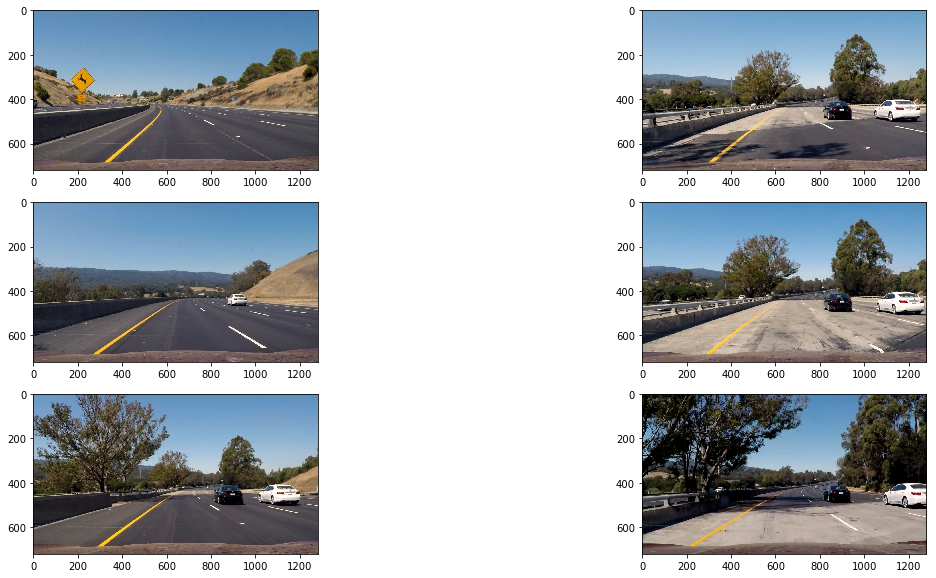

In [27]:
#set of calibration images
test_images = load_images("./test_images/*.jpg")
   
#shows the set of calibration images
show_images(test_images, nrows=3, ncols=2)

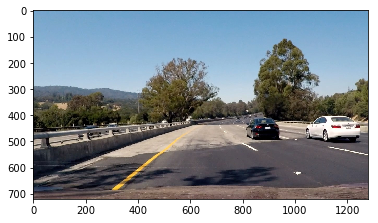

In [28]:
#we take this image to show examples.
image = test_images[1]
imshow(image);

In [29]:
# Here is your draw_boxes function from the previous exercise
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, tuple(bbox[0]), tuple(bbox[1]), color, thick)
    # Return the image copy with boxes drawn
    return imcopy

The get_boxes_from_image returns a sequence of boxes for an image. The boxes close to us are bigger that the fartest away.

Number of boxes per image 94


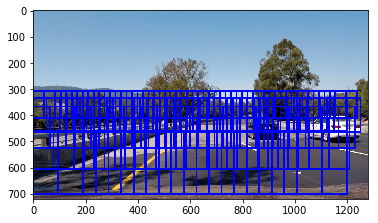

In [45]:
def get_boxes_from_image(image, min_y=400, start_size=250, end_size=100, overlap=0.6):
    max_y, max_x = image.shape[:2]
    x,y=0,max_y-20
    while y>min_y:
        size = int(end_size + (start_size-end_size)*(y-min_y)/(max_y-min_y))
        if size==0:break
        move = max(4,int((1-overlap)*size))
        while x+size<max_x:
            yield ((x,y),(x+size,y-size))
            x+=move
        y-=move
        x=0
    
boxes = list(get_boxes_from_image(image))
print("Number of boxes per image", len(boxes))
#print("Boxes", boxes)
imshow( draw_boxes(image,boxes));

The sliding_windows function is a generator that returns a sequence of windows. A window here is a tuple of box position and the image resized to 64x64. 

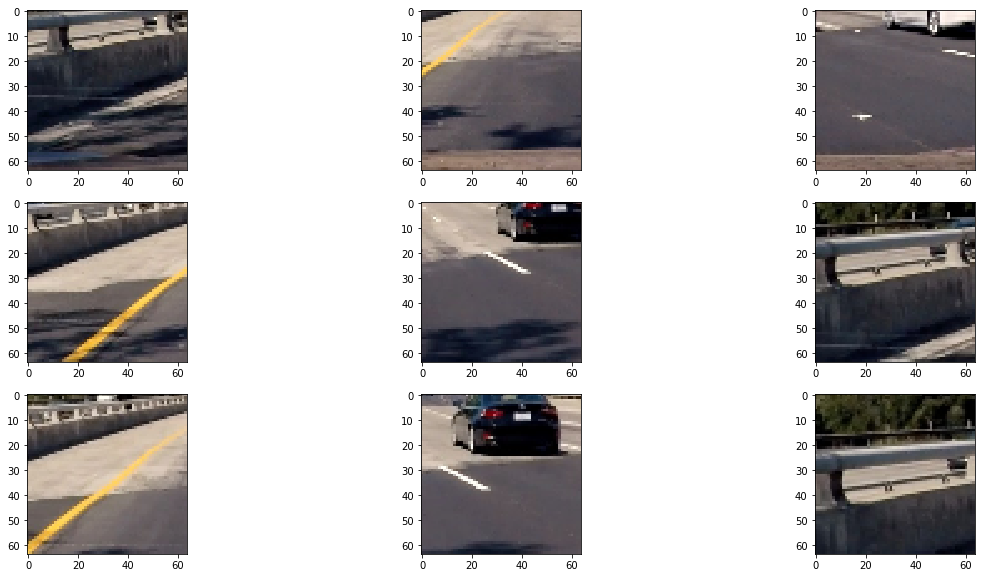

In [47]:
def sliding_windows(image, resize_to=64,min_y=450, start_size=250, end_size=100, overlap=0.8):
    boxes = get_boxes_from_image(image, min_y=min_y, start_size=start_size, end_size=end_size, overlap=overlap)
    for box in boxes:
        crop_image = image[box[1][1]:box[0][1], box[0][0]:box[1][0]]
        r_image = cv2.resize(crop_image, (resize_to, resize_to))
        yield box, r_image
        
rs = list(sliding_windows(image))
show_images([r[1] for r in rs[::10]], ncols=3,nrows=3)

find_cars is the first version of the function to detect vehicles inside an image. It uses the sliding_windows function with the classifier.

In [50]:
def find_cars(image, clf=clf):
    windows = tuple(sliding_windows(image))
    window_images = np.array([window[1] for window in windows])
    window_boxes = np.array([window[0] for window in windows])
    cars = clf.predict(window_images)
    boxes = window_boxes[cars==1.]
    return boxes, draw_boxes(image, boxes)
    
    
boxes, boxed_image = find_cars(image)

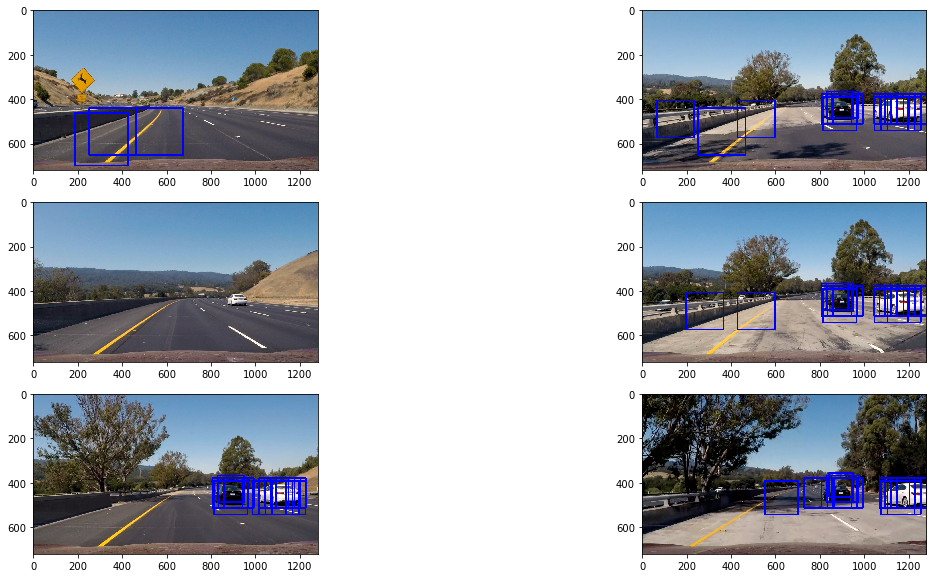

In [49]:
show_images([find_cars(image)[1] for image in test_images], nrows=3, ncols=2)

We have some false positives and mutiple detections on the vehicles.

### Heat map

We use the heatmap technique to compute multiple detections and apply a threshold.
If the boxis to small remove it too.

In [71]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import pickle
import cv2
from scipy.ndimage.measurements import label

class FindCarsWithHeatmap:
    start_size=250
    end_size=100
    overlap=0.8
    min_box_size=0
    def __init__(self, threshold=3, min_box_size=0):
        self.threshold=threshold
        self.min_box_size = min_box_size
        
    def get_boxes(self, image):
        windows = tuple(sliding_windows(image, start_size=self.start_size, end_size=self.end_size, overlap=self.overlap))
        window_images = np.array([window[1] for window in windows])
        window_boxes = np.array([window[0] for window in windows])
        cars = clf.predict(window_images)
        return window_boxes[cars==1.]

    def add_heat(self, heatmap, bbox_list):
        # Iterate through list of bboxes
        for box in bbox_list:
            # Add += 1 for all pixels inside each bbox
            # Assuming each "box" takes the form ((x1, y1), (x2, y2))
            # yield ((x,y),(x+size,y-size)
            heatmap[box[1][1]:box[0][1], box[0][0]:box[1][0]] += 1

        # Return updated heatmap
        return heatmap# Iterate through list of bboxes
    
    def draw_labeled_bboxes(self, img, labels):
        # Iterate through all detected cars
        for car_number in range(1, labels[1]+1):
            # Find pixels with each car_number label value
            nonzero = (labels[0] == car_number).nonzero()
            # Identify x and y values of those pixels
            nonzeroy = np.array(nonzero[0])
            nonzerox = np.array(nonzero[1])
            # Define a bounding box based on min/max x and y
            bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
            if (bbox[1][0] - bbox[0][0])<self.min_box_size or (bbox[1][1] - bbox[0][1])<self.min_box_size:
                continue
            # Draw the box on the image
            cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
        # Return the image
        return img
    
    def __call__(self, image):
        boxes = self.get_boxes(image)
        boxed_image = draw_boxes(image, boxes)
        heat = np.zeros_like(image[:,:,0]).astype(np.float)
        
        # Add heat to each box in box list
        heat = self.add_heat(heat,boxes)
        heat[heat<self.threshold]=0

        # Visualize the heatmap when displaying    
        heatmap = np.clip(heat, 0, 255)

        # Find final boxes from heatmap using label function
        labels = label(heatmap)
        return boxed_image,heatmap, self.draw_labeled_bboxes(np.copy(image), labels)



#build the function to find cars with heatmap threshold filter.
find_cars_with_heatmap = FindCarsWithHeatmap()    



In [62]:
def show_heatmap(images, figsize=(100, 150)):
    fig, axes = plt.subplots(nrows=len(images), ncols=3, figsize=figsize)
    for i,image in enumerate(images):
        boxed_image,heatmap, drawed_image = find_cars_with_heatmap(image)
        ax1 = axes.flat[3*i]
        ax2 = axes.flat[3*i+1]
        ax3 = axes.flat[3*i+2]
        ax1.imshow(boxed_image)
        ax2.imshow(heatmap, cmap="hot")
        ax3.imshow(drawed_image)
    fig.tight_layout()
#show the test images through the pipeline so we can inspect visually the results.
show_heatmap(test_images)


Because there are some false negatives in the resulting video I add more image examples from the video to be able to inspect better the detection results.

In [36]:
import imageio 

def load_images_from_video(filename, nframes=30):
    vid = imageio.get_reader(filename,  'ffmpeg')
    rs=[]
    for i, im in enumerate(vid):
        if i%nframes==0:
            rs.append(im)
    return rs


video_images = load_images_from_video('project_video.mp4') 


Threshold changed to 3
Showing ...


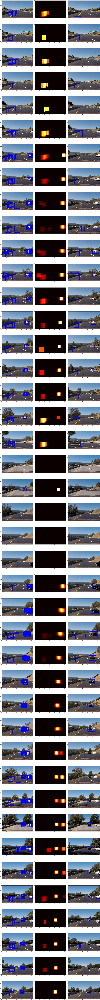

In [63]:
@interact(threshold=(1,10))
def g(threshold):
    print("Threshold changed to {}".format(threshold))
    find_cars_with_heatmap.threshold=threshold

@interact(start_size=FloatSlider(min=10, max=500, step=10, value=250))
def g(start_size):
    print("Start size changed to {}".format(start_size))
    find_cars_with_heatmap.start_size=start_size
    
@interact(end_size=FloatSlider(min=10, max=500, step=10, value=100))
def g(end_size):
    print("End size changed to {}".format(end_size))
    find_cars_with_heatmap.end_size=end_size
    
@interact(overlap=FloatSlider(min=0.1, max=0.9, step=0.1, value=0.9))
def g(overlap):
    print("Overlap changed to {}".format(overlap))
    find_cars_with_heatmap.overlap=overlap

@button("Show heatmap")
def f(event):
    print("Showing ...")
    show_heatmap(video_images, figsize=(30,300))

There are some false positives. Normaly around suared features, like road edge, traffic signals, ...
I adjusted differents parameters from the sliding_window function (size, min_y, max_y, ...) to find the best combination. First I removed regions above horizon and the bottom of the image where the front of the car is showed. At the end, because the presence of false positives, I choosed a high overlapping with a high threshold value. False positives appear only one in the left image. Cars are detected multiple times. In this way we can remove this false positives (right result).

I high overlapping makes it more computanicionally expansive but saver.

## Video implementation

We now apply the find car function to the video.

In [86]:
def pipelined_video(pipeline, video_output, video_input='project_video.mp4', process=False, subclip=None):
    '''
    helper video that process input video through pipeline and writes to video_output
    '''
    if process:
        clip1 = VideoFileClip(video_input)
        if subclip is None:
            white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
            %time white_clip.write_videofile(video_output, audio=False) 
        else:
            for start_time, end_time in subclip:
                sclip1 = clip1.subclip(start_time, end_time) 
                white_clip = sclip1.fl_image(pipeline) #NOTE: this function expects color images!!
                %time white_clip.write_videofile(video_output, audio=False) 
    return HTML("""
    <video width="960" height="540" controls>
      <source src="{0}">
    </video>
    """.format(video_output))

In [39]:
def pipeline_find_car(image):
    return find_cars_with_heatmap(image)[2]

pipelined_video( pipeline_find_car, 'find_car_video.mp4', process=False)

As we can see in the video appears some false positives. We have to add more complexity to the find car function to remove them.
I opted to add a history of previous boxes founded. This boxes are use to compute the heatmap of the current image. I use a hight threshold to filter false positives. False positives are normally only detected once in the picture and don't appear in other frames.
I adjusted history and threshold parameters manually after inspecting the video.


In [74]:
class FindCarsWithHeatmapWithHistory(FindCarsWithHeatmap):
    start_size=250
    end_size=100
    overlap=0.8
    min_box_size=0
    def __init__(self, threshold=10, history=3):
        self.threshold=threshold
        self._history_boxes = []
        self.history=history
        
    def get_boxes(self, image):
        boxes = FindCarsWithHeatmap.get_boxes(self,image)
        self._history_boxes = [boxes] + self._history_boxes[:self.history]
        rs=[]
        for boxes in self._history_boxes:rs.extend(boxes)
        return rs




find_cars_with_heatmap_with_history = FindCarsWithHeatmapWithHistory()    


In [81]:
@interact(threshold=IntSlider(min=1, max=50, value=19))
def g(threshold):
    print("Threshold changed to {}".format(threshold))
    find_cars_with_heatmap_with_history.threshold=threshold

@interact(history=IntSlider(min=1, max=10, value=5))
def g(history):
    print("History changed to {}".format(history))
    find_cars_with_heatmap_with_history.history=history
    
@interact(start_size=FloatSlider(min=10, max=500, step=10, value=250))
def g(start_size):
    print("Start size changed to {}".format(start_size))
    find_cars_with_heatmap_with_history.start_size=start_size
    
@interact(end_size=FloatSlider(min=10, max=500, step=10, value=100))
def g(end_size):
    print("End size changed to {}".format(end_size))
    find_cars_with_heatmap_with_history.end_size=end_size
    
@interact(overlap=FloatSlider(min=0.1, max=0.9, step=0.1, value=0.9))
def g(overlap):
    print("Overlap changed to {}".format(overlap))
    find_cars_with_heatmap_with_history.overlap=overlap


Threshold changed to 19


In [90]:
pipelined_video( lambda img:find_cars_with_heatmap_with_history(img)[2], 
                    'test_final_video.mp4', video_input='test_video.mp4', process=True)

[MoviePy] >>>> Building video test_final_video.mp4
[MoviePy] Writing video test_final_video.mp4


 97%|█████████▋| 38/39 [00:47<00:01,  1.21s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_final_video.mp4 

CPU times: user 1min 23s, sys: 16.5 s, total: 1min 39s
Wall time: 49.5 s


To investigate more I create a subclip of the video.

In [91]:
pipelined_video( lambda img:find_cars_with_heatmap_with_history(img)[2], 
                    'project_final_video_0_2.mp4', process=True, subclip=[(0,2)])

[MoviePy] >>>> Building video project_final_video_0_2.mp4
[MoviePy] Writing video project_final_video_0_2.mp4


 98%|█████████▊| 50/51 [01:00<00:01,  1.22s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_final_video_0_2.mp4 

CPU times: user 1min 45s, sys: 21.7 s, total: 2min 7s
Wall time: 1min 2s


This is the final video. It's called project_final_video.mp4

In [92]:
pipelined_video( lambda img:find_cars_with_heatmap_with_history(img)[2], 
                    'project_final_video.mp4', process=True)

[MoviePy] >>>> Building video project_final_video.mp4
[MoviePy] Writing video project_final_video.mp4


100%|█████████▉| 1260/1261 [27:27<00:01,  1.20s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_final_video.mp4 

CPU times: user 46min 58s, sys: 8min 54s, total: 55min 53s
Wall time: 27min 29s


## Conclusion

The vehicle tracking algorithm still have a big problem. It's very slow and is not usable in real time from my machine.
I see the importance to work on every step orderly to get a good final result. First work with the classifier pipeline and optimize to get the best performance.
After that working with the sliding windows technique to be able to to detect cars in a bigger image. I had to add more examples. With this extra samples I adjusted the sliding windows parameters to detect all cars in the image and avoid all the false positives.
Even so in the video pipeline I had many false positives. They appeared in a frame or 2. So I considered previous detection to be able to remove this cases.

At some moments the classifiers doesn't detect the white car. I have to investigate more the cause of it.
The classfier also detects some cars from the other side of the road. That can be a bit confusing but it's ok that the classifier detects them.

Also sometimes a car appears as 2. To avoid that I had to adjust better the windows sizes. When 2 cars are together the box clip both together.

I observed that many false positives where around squared objects and straight lines. Like traffic signs and road edges. I think it would be important to include more traffic sign examples as non-vehicles data.

I didn't try others classifiers like RandomForestClassifier. Also, many classifiers can be used at the same time with the VotingClassifier.